# CCLE RNS-Seq Data Visualization

Fan Wang

June 10th 2022

The Cancer Cell Line Encyclopedia (CCLE) project is an effort to conduct a detailed genetic characterization of a large panel of human cancer cell lines. The CCLE provides public access analysis and visualization of DNA copy number, mRNA expression, mutation data and more, for more than 1000 cancer cell lines. This notebook demonstrates how to visualize the gene expression for cell lines of interest. CCLE gene expression data was pulled from BRH and formatted using Pandas and then visualized using Seaborn.

## Accessing the CCLE Data

In [7]:
import pandas as pd
import seaborn as sns

sns.set(style="ticks", color_codes=True)
get_ipython().run_line_magic("config", "InlineBackend.figure_format = 'svg'")
import matplotlib.pyplot as plt
import seaborn as sns
import zipfile
import warnings

warnings.filterwarnings("ignore")

In [2]:
!pip install gen3 -U
!gen3 drs-pull object dg.OADC/41c3f1ac-2cc7-4b04-b09c-a9c5dbad2c98 --no-unpack-packages

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.0/109.0 kB 22.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for drsclient: filename=drsclient-0.2.1-py3-none-any.whl size=7417 sha256=39f08cecc9ea43b7cad4684ca07d36a801b1e8c9bd15384f3ac3c902ee30f05a
  Stored in directory: /home/jovyan/.cache/pip/wheels/fa/14/cf/4242c44ed310a955ad62575b92f4b81c24852e388dca1d6385
Successfully built drsclient
  Attempting uninstall: drsclient
    Found existing installation: drsclient 0.1.4
    Uninstalling drsclient-0.1.4:
      Successfully uninstalled drsclient-0.1.4
  Attempting uninstall: gen3
    Found existing installation: gen3 4.6.3
    Uninstalling gen3-4.6.3:
      Successfully uninstalled gen3-4.6.3


In [5]:
path_to_zip_file_expression ="CCLE_data_22Q2.zip"

with zipfile.ZipFile(path_to_zip_file_expression, 'r') as zip_ref:
    zip_ref.extractall()

## Extraction of top 2000 genes with the largest variation

In [6]:
# Read sample_info and insert only cell lines with lineage 'lung'.
sample_info = pd.read_csv("CCLE_data_22Q2/sample_info_22Q2.csv")
lung = sample_info[sample_info["lineage"] == "lung"]

# Read the expression data and edit the gene column name.
expression = pd.read_csv("CCLE_data_22Q2/CCLE_expression_22Q2.csv", sep=",")
expression.columns = [line.split(" ")[0] for line in expression.columns.to_list()]
expression.rename(columns={"Unnamed:": "Cell Line"}, inplace=True)

# Merge expression data of cells of blood lineage into data frame called lungexpressAll.
lungexpressAll = pd.merge(
    lung, expression, left_on="DepMap_ID", right_on="Cell Line", how="inner"
)

# Create a list of unnecessary columns and delete them.
removecolumnlist = lung.columns.to_list()
removecolumnlist.remove("stripped_cell_line_name")
removecolumnlist.append("Cell Line")
lungexpressAll.drop(removecolumnlist, axis=1, inplace=True)
lungexpressAll.set_index("stripped_cell_line_name", inplace=True)

# Swap columns and indexes.
LE = lungexpressAll.transpose()

# Select the top 2000 HVGs with the largest variation,
Top2000 = LE.var(axis=1).sort_values(ascending=False)[0:2000]
val = LE.loc[Top2000.index]

## Comparison of expression similarity between cell lines by correlation

In [7]:
correlation = val.corr()
correlation

stripped_cell_line_name,NCIH1819,SALE,NCIH1618,NCIH889,NCIH1184,SQ1,JL1,NCIH854,NCIH1385,T3M10,...,DV90,NCIH2110,NCIH650,NCIH2342,HCC2450,NCIH1155,NCIH292,LC1SQSF,SCLC22H,LU135
stripped_cell_line_name,,,,,,,,,,,,,,,,,,,,,
NCIH1819,1.000000,0.485578,0.287696,0.167879,0.187428,0.516792,0.345822,0.358988,0.192794,0.420964,...,0.410416,0.530498,0.341989,0.692735,0.400669,0.227765,0.507148,0.421654,0.158397,0.140666
SALE,0.485578,1.000000,0.074010,-0.033752,-0.048017,0.693487,0.488306,0.378980,0.027095,0.672050,...,0.496662,0.586875,0.456705,0.512722,0.424270,0.053416,0.781673,0.464621,0.001774,-0.002607
NCIH1618,0.287696,0.074010,1.000000,0.605183,0.685070,0.111884,0.064536,0.302465,0.525158,0.020139,...,0.152469,0.144963,0.074072,0.236139,0.068344,0.514212,0.084972,0.225485,0.579617,0.549149
NCIH889,0.167879,-0.033752,0.605183,1.000000,0.587836,0.010820,0.017375,0.212685,0.536791,-0.018484,...,0.094586,0.022048,0.070789,0.095501,0.066186,0.534221,-0.052797,0.146696,0.615936,0.482970
NCIH1184,0.187428,-0.048017,0.685070,0.587836,1.000000,-0.026200,0.132159,0.134854,0.477524,-0.048107,...,0.018895,-0.036299,0.133998,0.060013,0.125298,0.590960,-0.051525,0.199748,0.531780,0.620065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NCIH1155,0.227765,0.053416,0.514212,0.534221,0.590960,0.086377,0.179788,0.263468,0.490881,0.082765,...,0.141748,0.071152,0.243054,0.137546,0.220530,1.000000,0.045065,0.226532,0.554269,0.631677
NCIH292,0.507148,0.781673,0.084972,-0.052797,-0.051525,0.660441,0.504858,0.342340,0.025813,0.677222,...,0.487584,0.645951,0.386423,0.544095,0.413807,0.045065,1.000000,0.453884,-0.015345,-0.004720
LC1SQSF,0.421654,0.464621,0.225485,0.146696,0.199748,0.392014,0.432092,0.269084,0.248377,0.436422,...,0.349939,0.421808,0.384609,0.411621,0.410761,0.226532,0.453884,1.000000,0.141574,0.239485


## Visualize data matrix as heatmap. The higher correlation, the more similar cell lines

<AxesSubplot:xlabel='stripped_cell_line_name', ylabel='stripped_cell_line_name'>

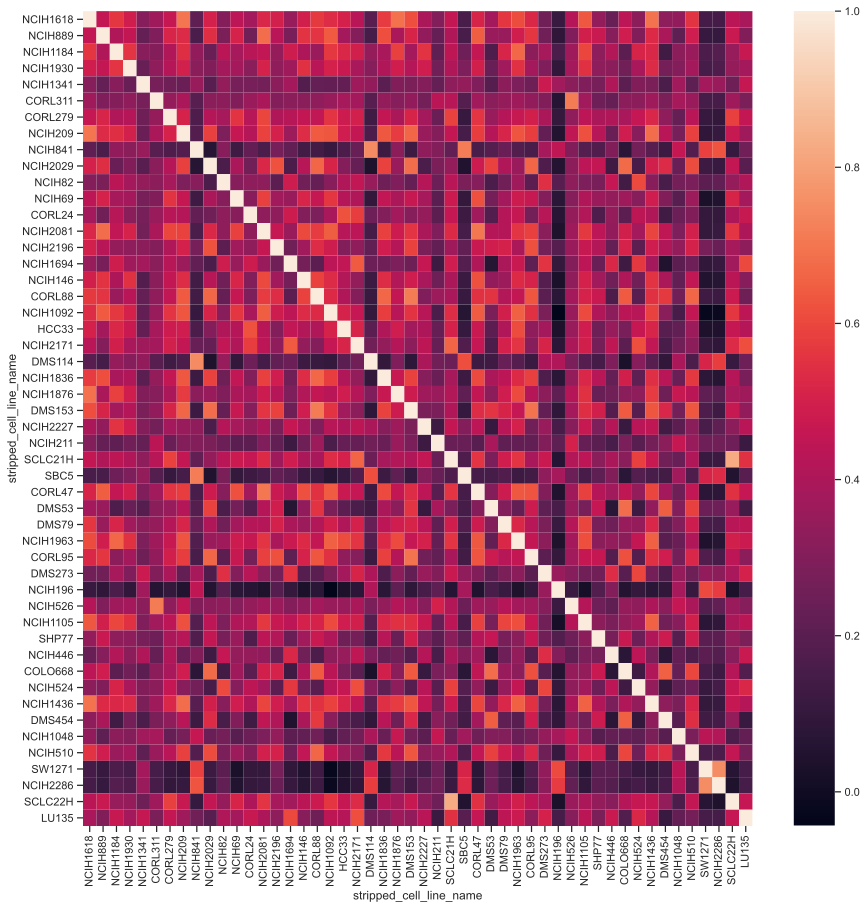

In [8]:
plt.figure(figsize=(15,15))
sns.heatmap (correlation)

## Let's see the difference according to lineage subtypes
### 1. Non-Small Cell Lung Cancer (NSCLC) lineage subtype

In [9]:
SCLC = lung[lung["lineage_subtype"] == "NSCLC"]
SCLCexpressAll = pd.merge(
    SCLC, expression, left_on="DepMap_ID", right_on="Cell Line", how="inner"
)
removecolumnlist = SCLC.columns.to_list()
removecolumnlist.remove("stripped_cell_line_name")
removecolumnlist.append("Cell Line")
SCLCexpressAll.drop(removecolumnlist, axis=1, inplace=True)
SCLCexpressAll.set_index("stripped_cell_line_name", inplace=True)

SCLC_expression = SCLCexpressAll.transpose()

Top2000 = SCLC_expression.var(axis=1).sort_values(ascending=False)[0:2000]
val = SCLC_expression.loc[Top2000.index]
correlation = val.corr()
plt.figure(figsize=(15, 15))
sns.heatmap(correlation)

<AxesSubplot:xlabel='stripped_cell_line_name', ylabel='stripped_cell_line_name'>

### 2. Small Cell Lung Cancer (SCLC) lineage subtype

<AxesSubplot:xlabel='stripped_cell_line_name', ylabel='stripped_cell_line_name'>

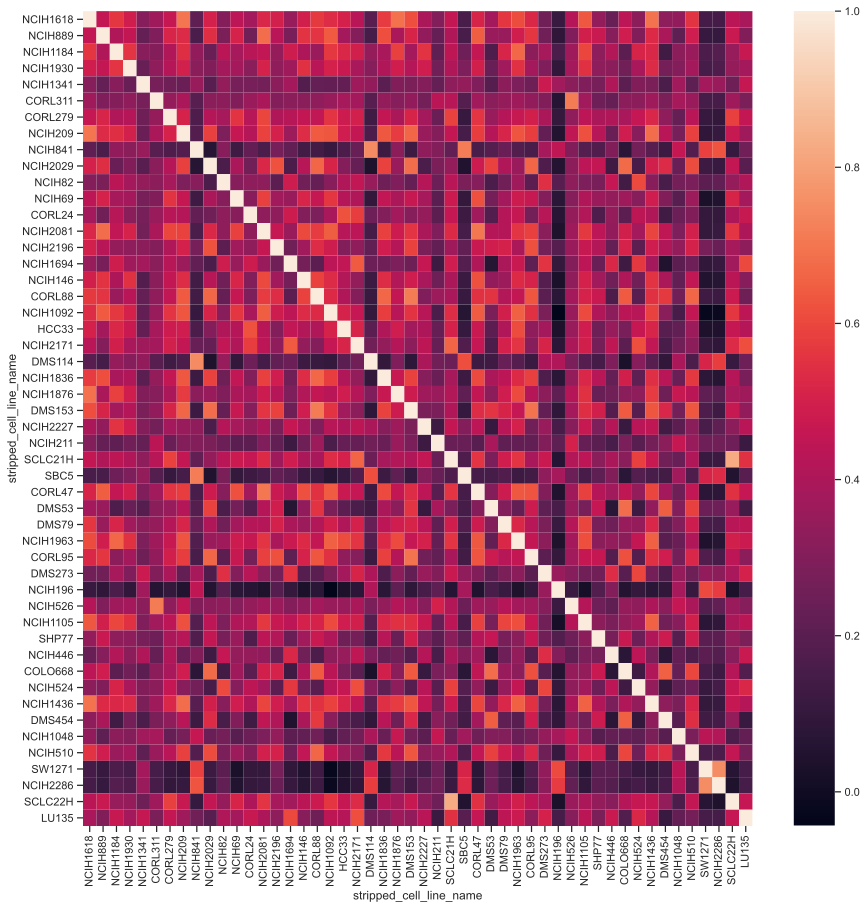

In [10]:
SCLC = lung[lung["lineage_subtype"] == "SCLC"]
SCLCexpressAll = pd.merge(
    SCLC, expression, left_on="DepMap_ID", right_on="Cell Line", how="inner"
)
removecolumnlist = SCLC.columns.to_list()
removecolumnlist.remove("stripped_cell_line_name")
removecolumnlist.append("Cell Line")
SCLCexpressAll.drop(removecolumnlist, axis=1, inplace=True)
SCLCexpressAll.set_index("stripped_cell_line_name", inplace=True)

SCLC_expression = SCLCexpressAll.transpose()

Top2000 = SCLC_expression.var(axis=1).sort_values(ascending=False)[0:2000]
val = SCLC_expression.loc[Top2000.index]
correlation = val.corr()
plt.figure(figsize=(15, 15))
sns.heatmap(correlation)

## Cell lines with similar gene expression patterns can be grouped together using Clustermap

In [11]:
plt.figure(figsize=(13,13))

g = sns.clustermap(val,figsize=(13,13))

<Figure size 936x936 with 0 Axes>

### From Above, SW1271 cell line (second column) and NCIH2286 cell line (third column) appear to be clustered together, but the distance between these two cell lines and NCIH2171 cell line (last column) is far apart. Let's look at the distribution according to gene expression for each cell line

In [12]:
twoset = val[["SW1271", "NCIH2286"]]
twoset

stripped_cell_line_name,SW1271,NCIH2286
ASCL1,0.163499,0.678072
RPS4Y1,0.722466,0.378512
GRP,0.176323,0.275007
CALCA,0.214125,1.028569
XAGE1A,10.048623,0.678072
...,...,...
KIRREL2,1.327687,3.941106
TSPAN13,1.855990,2.646163
KDELR3,4.369466,4.486071
VAV3,0.389567,1.835924


### Let's visualize the relationship between SW1271 and NCIH2286 with a scatter plot and a regression line

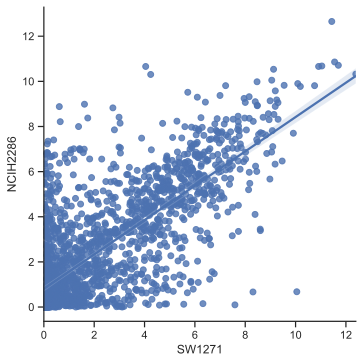

In [13]:
sns.lmplot(data=twoset, x="SW1271", y="NCIH2286")

### Find the correlation between the expression of two cell lines

In [14]:
twoset["SW1271"].corr(twoset["NCIH2286"])

0.7532543855591219

The correlation coefficient is 0.75, which shows a fairly high correlation. Being located nearby in the clustermap means that the same gene is expressed in a similar manner in two cell lines.

### Now let's compare two distant cell lines in the clustermap

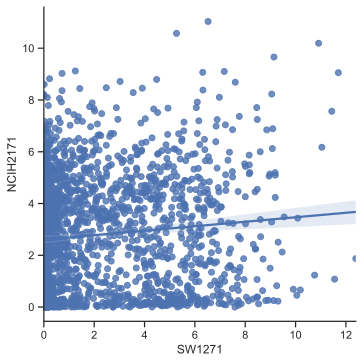

In [15]:
otherset = val[["SW1271", "NCIH2171"]]
sns.lmplot(data=otherset, x="SW1271", y="NCIH2171")

In [16]:
otherset["SW1271"].corr(otherset["NCIH2171"])

0.09937315675624152

As we expected, the correlation is low between two distant cell lines in the clustermap.

### Visualize correlations for multiple cell lines

In [17]:
sets = val[["SW1271", "NCIH2286", "NCIH2171", "NCIH196"]]
g = sns.PairGrid(sets)
g.map(sns.scatterplot)

In [18]:
sets = val[["SW1271", "NCIH2286", "NCIH2171", "NCIH196"]]
g = sns.PairGrid(sets)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

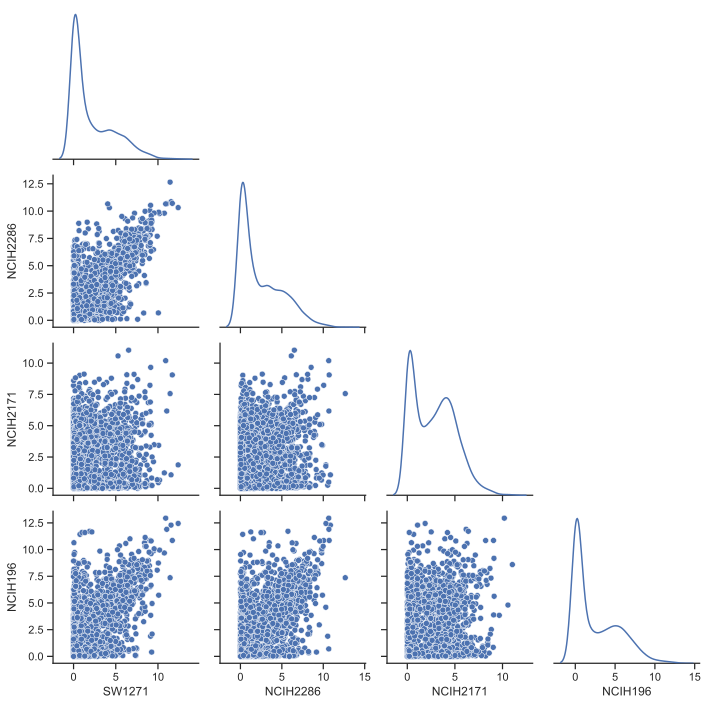

In [19]:
g = sns.PairGrid(sets, diag_sharey=False, corner=True)
g.map_lower(sns.scatterplot)
g.map_diag(sns.kdeplot)

## Summary
We retrieved CCLE expression dataset from BRH. Then we focused on the top 2000 genes with the largest variation and ploted a clustermap for these highly variable genes (HVG). From the clustermap, nearby and distant cell lines were selected and correlation was visualized. Then we ploted the correlation for muiltiple cell lines as a scatter plot using PairGrid.